In [1]:
import os

%matplotlib inline
import matplotlib.pyplot as plt

from IPython.display import Image

### Planogram

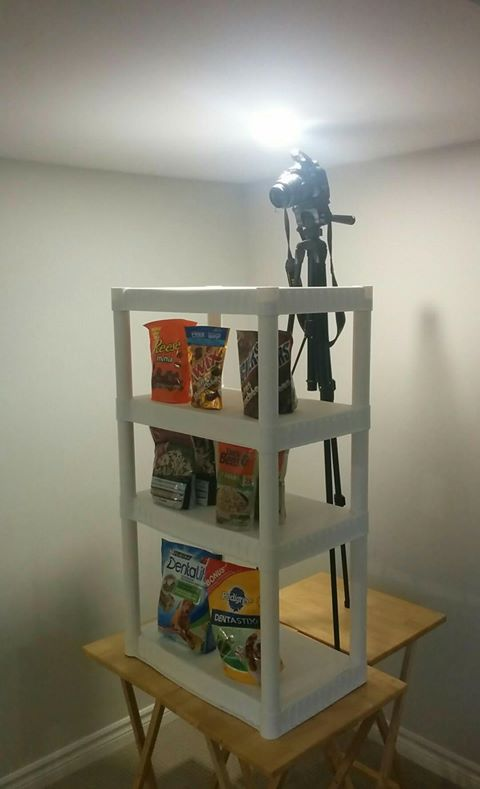

In [2]:
Image(filename='planogram.jpg')

The products are:

```
---------------------------
| REESE | TWIX | SNICKERS |
---------------------------
| SENSATIONS | UNCLE BENS |
---------------------------
| DENTALITE  | DENTASTIX  |
---------------------------
```

### Original Video

In [3]:
cd data

/home/elijahtai/Documents/github.com/vendlytics/notebooks/visualization/data


In [4]:
ls

output-_local_1.txt  video-det-fold-_local.txt  videos/


In [5]:
cd videos

/home/elijahtai/Documents/github.com/vendlytics/notebooks/visualization/data/videos


In [6]:
ls

Camera 1 - Vendlytics Prototype.mp4  output-_local_1.avi  output-_local.avi


In [7]:
cd ../..

/home/elijahtai/Documents/github.com/vendlytics/notebooks/visualization


In [8]:
DATA_DIR = 'data'
VIDEOS_DIR = 'videos'

ORIGINAL_VIDEO_FILENAME = 'Camera 1 - Vendlytics Prototype.mp4'
FACE_DETECTION_VIDEO_FILENAME = 'output-_local.avi'
GAZE_DETECTION_VIDEO_FILENAME = 'output-_local_1.avi'

FACE_BBOXES_FILENAME = 'video-det-fold-_local.txt'
GAZE_ANGLES_FILENAME = 'output-_local_1.txt'

ORIGINAL_VIDEO_PATH = os.path.join(DATA_DIR, VIDEOS_DIR, ORIGINAL_VIDEO_FILENAME)
FACE_DETECTION_VIDEO_PATH = os.path.join(DATA_DIR, VIDEOS_DIR, FACE_DETECTION_VIDEO_FILENAME)
GAZE_DETECTION_VIDEO_PATH = os.path.join(DATA_DIR, VIDEOS_DIR, GAZE_DETECTION_VIDEO_FILENAME)
FACE_BBOXES_PATH = os.path.join(DATA_DIR, FACE_BBOXES_FILENAME)
GAZE_ANGLES_PATH = os.path.join(DATA_DIR, GAZE_ANGLES_FILENAME)

In [9]:
from moviepy.editor import *

original_video = VideoFileClip(ORIGINAL_VIDEO_PATH).subclip(t_start=27, t_end=87)
original_video.ipython_display(width=500)

100%|█████████▉| 240/241 [00:01<00:00, 162.30it/s]


In [10]:
face_video = VideoFileClip(FACE_DETECTION_VIDEO_PATH).subclip(t_start=27, t_end=87)
face_video.ipython_display(width=500)

100%|█████████▉| 300/301 [00:02<00:00, 136.96it/s]


In [235]:
gaze_video = VideoFileClip(GAZE_DETECTION_VIDEO_PATH).subclip(t_start=27, t_end=87)
gaze_video.ipython_display(width=500)

100%|█████████▉| 1800/1801 [00:10<00:00, 171.20it/s]


### Visualize Gaze

In [148]:
import pandas as pd
import numpy as np

In [78]:
bbox_df = pd.read_csv(FACE_BBOXES_PATH, delimiter=' ', header=None)
bbox_df.columns = ['frame_number', 'x_min', 'y_min', 'x_max', 'y_max', 'confidence_score']

In [80]:
bbox_df.head()

,frame_number,x_min,y_min,x_max,y_max,confidence_score
0,668,0.000000,2.769838,36.433937,53.557083,0.960417
1,671,3.186478,2.641691,66.019836,53.837234,0.879167
2,681,74.091316,0.000000,129.792801,66.953537,0.944494
3,682,71.471588,0.000000,143.034180,67.177017,0.987946
4,683,67.986679,0.000000,136.474899,64.204681,0.987006


In [135]:
gaze_df = pd.read_csv(GAZE_ANGLES_PATH, delimiter=' ', header=None)
gaze_df.columns = ['frame_number', 'x_angle', 'y_angle', 'z_angle']

In [136]:
gaze_df.head()

,frame_number,x_angle,y_angle,z_angle
0,682,-9.101837,-4.555634,-0.912392
1,683,-13.126450,-1.246826,-1.620468
2,684,-15.179825,2.938110,1.712021
3,685,-17.545975,4.570633,-1.424942
4,686,-15.356705,-1.959663,3.927353


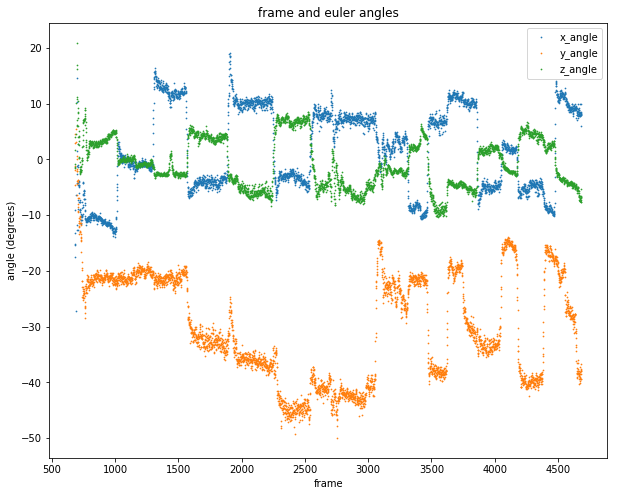

In [134]:
MARKER_SIZE = 0.5
FRAME_LIMIT = 4000

fig = plt.figure(figsize=(10, 8))
ax1 = fig.add_subplot(111)

x = gaze_df.T.loc[0][:FRAME_LIMIT]
ax1.scatter(x, gaze_df.T.loc[1][:FRAME_LIMIT], s=MARKER_SIZE) # x angle
ax1.scatter(x, gaze_df.T.loc[2][:FRAME_LIMIT], s=MARKER_SIZE) # y angle
ax1.scatter(x, gaze_df.T.loc[3][:FRAME_LIMIT], s=MARKER_SIZE) # z angle

plt.title("frame and euler angles")
plt.xlabel("frame")
plt.ylabel("angle (degrees)")

plt.legend(["x_angle", "y_angle", "z_angle"])
fig.show()

Correlate the angles with the products.

Need to project out angles to new space and use that as target.

In [69]:
# times (s) when ashton was looking at each of 7 products
TIME_MARKERS_SEC = [27, 34, 44, 53, 66, 77, 87]

# we know video is 30 fps, so 30 * TIME_MARKERS_SEC[i] 
# (where i is single product) gives us frame to use angle from
TIME_MARKERS_FRAMES = [(30 * i) for i in TIME_MARKERS_SEC]

In [70]:
TIME_MARKERS_FRAMES

[810, 1020, 1320, 1590, 1980, 2310, 2610]

In [238]:
# since gaze_video starts at 27
TIME_MARKERS_FOR_VIDEO = [(i - 27) for i in TIME_MARKERS_SEC]


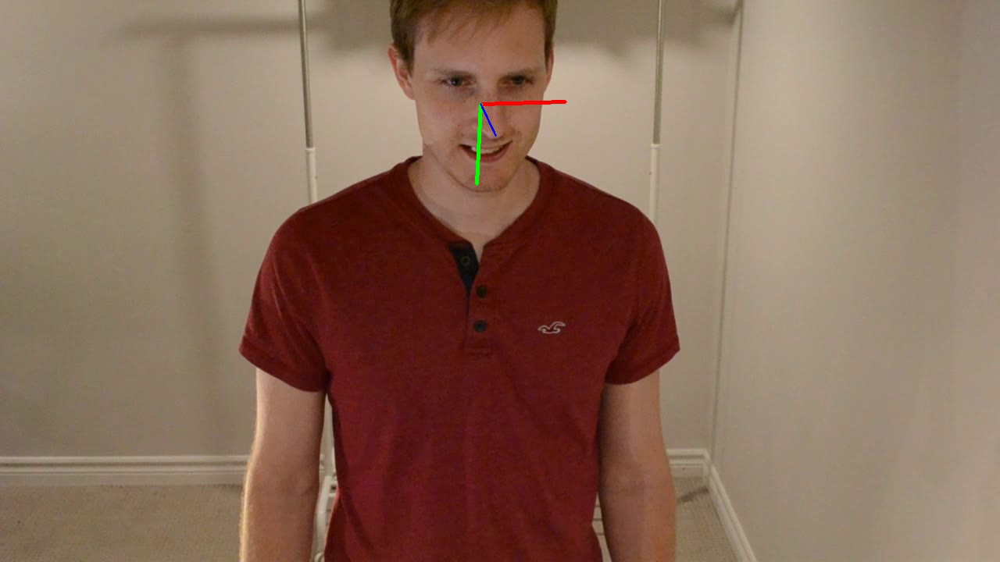

In [236]:
gaze_video.ipython_display(t=TIME_MARKERS_FOR_VIDEO[0], width=500)


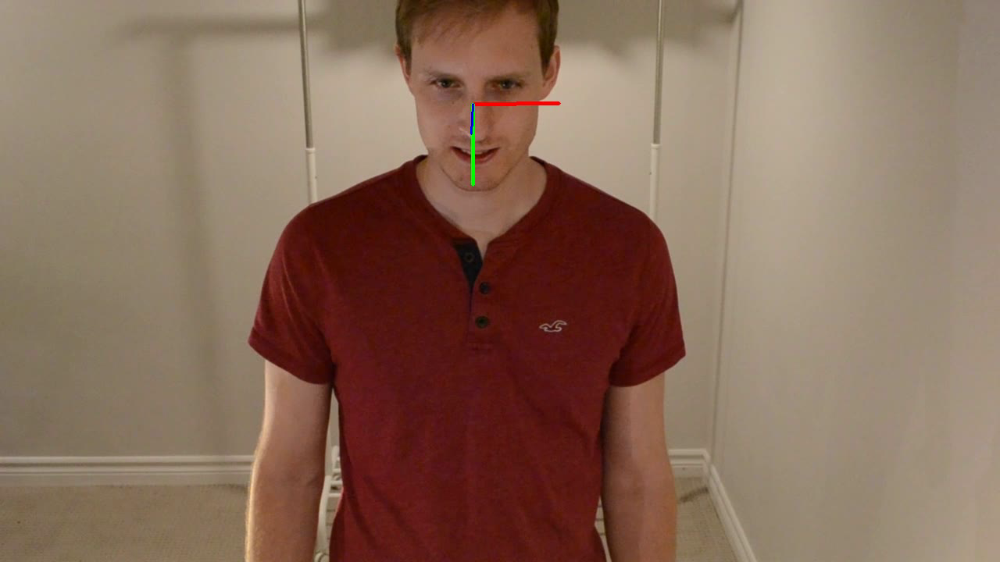

In [237]:
gaze_video.ipython_display(t=TIME_MARKERS_FOR_VIDEO[1], width=500)


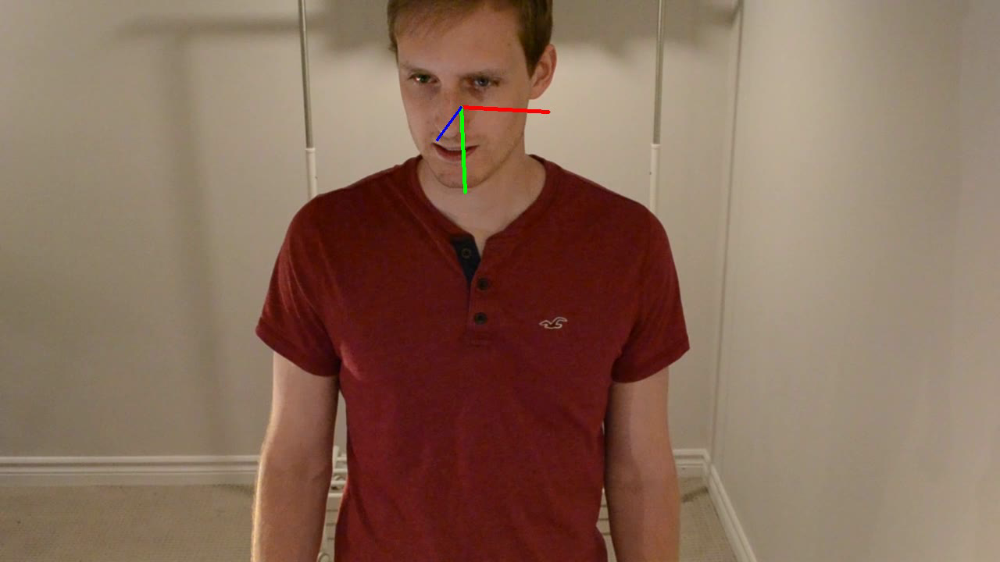

In [239]:
gaze_video.ipython_display(t=TIME_MARKERS_FOR_VIDEO[2], width=500)


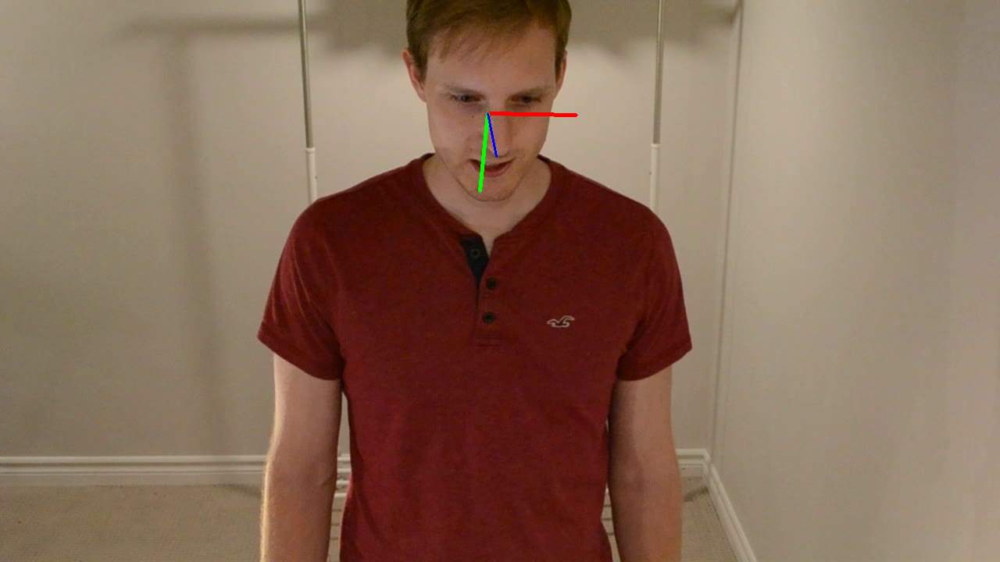

In [241]:
gaze_video.ipython_display(t=TIME_MARKERS_FOR_VIDEO[3], width=500)


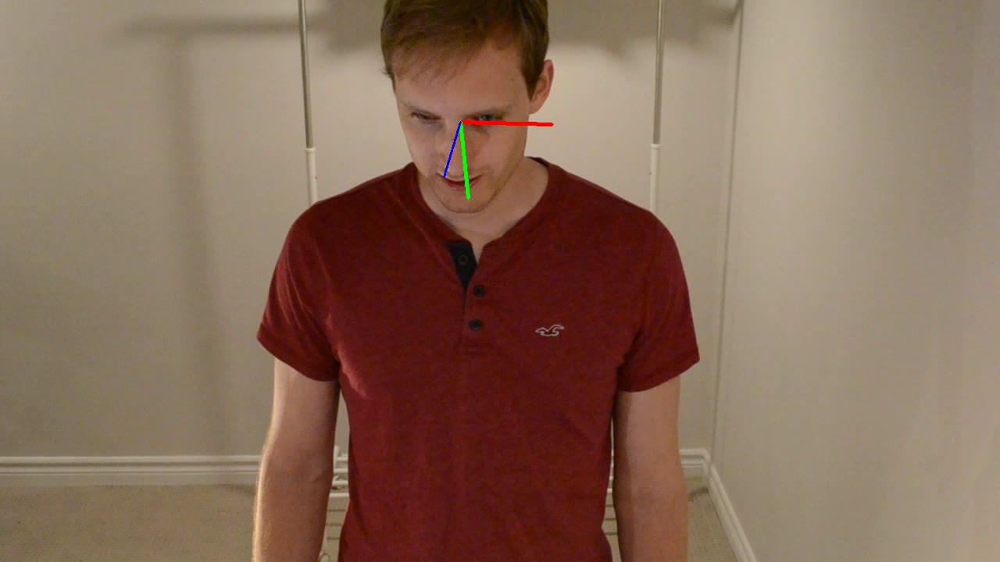

In [242]:
gaze_video.ipython_display(t=TIME_MARKERS_FOR_VIDEO[4], width=500)


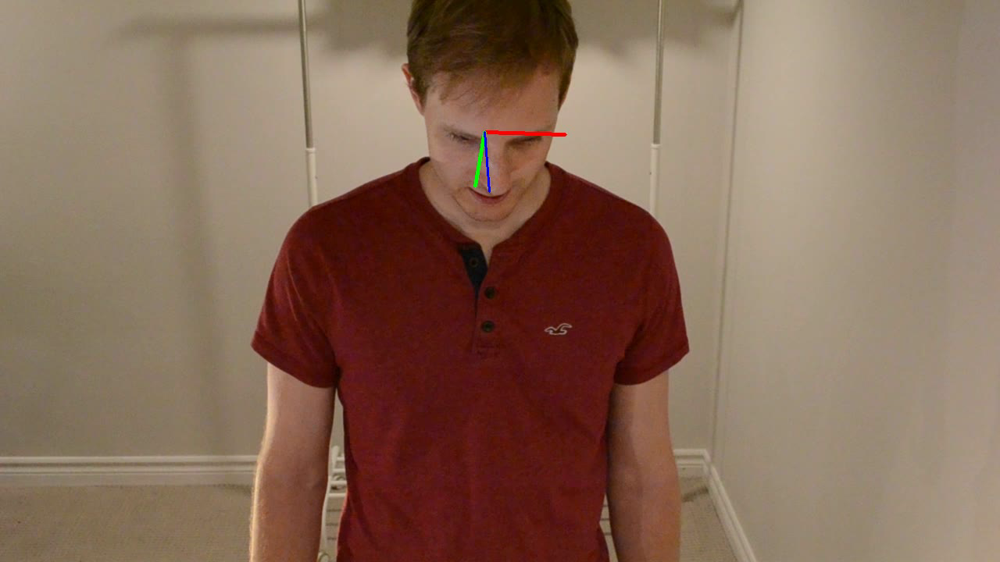

In [243]:
gaze_video.ipython_display(t=TIME_MARKERS_FOR_VIDEO[5], width=500)


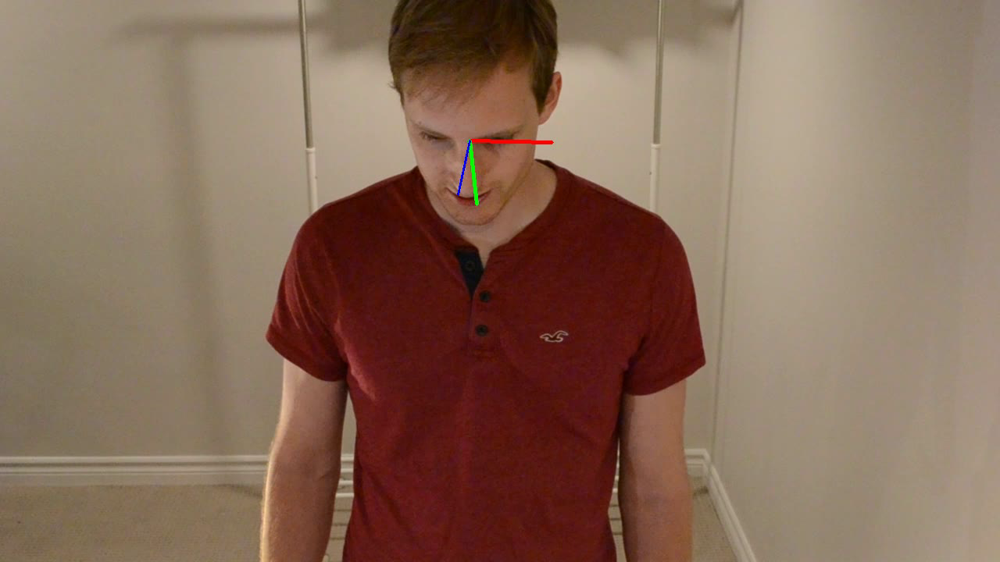

In [244]:
gaze_video.ipython_display(t=TIME_MARKERS_FOR_VIDEO[6], width=500)

For each of the times, let's get the:
- position of face bounding box (centroid of rectangle)
- size of face bounding box
- gaze x_angle
- gaze y_angle
- gaze z_angle

In [146]:
def calculate_rectangle_centroid(min_x, min_y, max_x, max_y):
    """
    Returns a tuple (x, y) which gives the position of the face bounding box.
    """
    return (min_x + max_x) / 2, (min_y + max_y) / 2  


def calculate_rectangle_area(min_x, min_y, max_x, max_y):
    """
    Returns the pixel area of the face bounding box.
    """
    return (max_x - min_x) * (max_y - min_y)

rect_centroids = []
rect_areas = []
gaze_x_angles = []
gaze_y_angles = []
gaze_z_angles = []

for frame in TIME_MARKERS_FRAMES:
    error = True
    print("frame", frame)
    
    # bbox
    bbox_coords = bbox_df.loc[bbox_df["frame_number"] == frame][['x_min', 'y_min', 'x_max', 'y_max']].as_matrix()[0]
    rect_centroid = calculate_rectangle_centroid(bbox_coords[0], bbox_coords[1], bbox_coords[2], bbox_coords[3])
    rect_area = calculate_rectangle_area(bbox_coords[0], bbox_coords[1], bbox_coords[2], bbox_coords[3])
    
    # gaze
    gaze_x_angle = gaze_df.loc[gaze_df["frame_number"] == frame]['x_angle'].values[0]
    gaze_y_angle = gaze_df.loc[gaze_df["frame_number"] == frame]['y_angle'].values[0]
    gaze_z_angle = gaze_df.loc[gaze_df["frame_number"] == frame]['z_angle'].values[0]
    
    rect_centroids.append(rect_centroid)
    rect_areas.append(rect_area)
    gaze_x_angles.append(gaze_x_angle)
    gaze_y_angles.append(gaze_y_angle)
    gaze_z_angles.append(gaze_z_angle)
    
    print("rect_centroid", rect_centroid)
    print("rect_area", rect_area)
    print("gaze_angles", gaze_x_angle, gaze_y_angle, gaze_z_angle)
    print()

frame 810
rect_centroid (616.0491945, 126.5688365)
rect_area 36319.58733578324
gaze_angles -10.052559 -22.204826 2.971756

frame 1020
rect_centroid (611.9037475, 128.84858699999998)
rect_area 33566.448310076514
gaze_angles 0.6010439999999999 -21.253487 -0.259758

frame 1320
rect_centroid (590.1170655000001, 129.6297)
rect_area 41245.215513194395
gaze_angles 14.703918 -21.64035 -3.00988

frame 1590
rect_centroid (628.3658445, 147.5313225)
rect_area 40367.22368811869
gaze_angles -6.091812 -29.846771 6.084625

frame 1980
rect_centroid (589.586182, 163.5399395)
rect_area 42083.30767426981
gaze_angles 9.122009 -35.937481 -5.6077580000000005

frame 2310
rect_centroid (626.1864625000001, 190.490295)
rect_area 33974.11804128589
gaze_angles -2.764481 -43.803978 7.148834

frame 2610
rect_centroid (602.975159, 191.2623025)
rect_area 33394.988915642076
gaze_angles 8.142638999999999 -40.930252 -5.009583



`rect_area` is important because it gives us a sense of the distance of the face from the camera.

Resolution of video is: `1280 (x) by 786 (y)`.

### Time to project to plane.

Assume:
- that the shelves are directly underneath the camera

Need to build a "virtual shelf" that's not actually in the view of the camera.

The plane created by the `x` (red in video), `y` (green in video) Euler angles gives the plane of the shelves. The distance of the person from the shelf can be calibrated by a rough estimate first, and then we can use `size2depth` or something that estimates depth from 2d images (later).

In [150]:
# creating the shelf plane

# can define shelf plane with just the point (rect_centroid) 
# and normal vector (to be calculated)

# then the distance of the shelves from the person with some estimate
# to move that plane in the direction of the norm vector
print(gaze_x_angles[0], gaze_y_angles[0], gaze_z_angles[0])
yaw_angle = gaze_x_angles[0]
pitch_angle = gaze_y_angles[0]

approx_distance_from_shelf = 100

-10.052559 -22.204826 2.971756
[ 0.79092672 -0.57399263  0.21205512]


In [414]:
def convert_from_euler_angle_to_vector(yaw_angle, pitch_angle):
    """
    Converts from angles to directional vector.
    """
    yaw_angle_radians = yaw_angle * np.pi / 180
    pitch_angle_radians = pitch_angle * np.pi / 180
    return np.array([
        np.cos(yaw_angle_radians) * np.cos(pitch_angle_radians),
        np.sin(yaw_angle_radians) * np.cos(pitch_angle_radians),
        np.sin(pitch_angle_radians)
    ])

In [380]:
# what does the vector look like?
def plot_directional_vectors(z_vectors):
    from mpl_toolkits.mplot3d import Axes3D
    fig = plt.figure(figsize=(5, 5))
    
    ax = fig.gca(projection='3d')
    ax.set_xlim3d(-1, 2)
    ax.set_ylim3d(-1, 2)
    ax.set_zlim3d(-1, 2)
    ax.hold(True)
    
    for z_vector in z_vectors:
        print(z_vector)
        ax.quiver(0, 0, 0, *z_vector, length = 5)

    plt.show()

In [381]:
z_vectors = []
for yaw, pitch in zip(gaze_x_angles, gaze_z_angles):
    z_vector = convert_from_euler_angle_to_vector(yaw, pitch)    
    z_vectors.append(z_vector)

[ 0.9833239  -0.17431676  0.05184367]
[ 0.9999347   0.0104899  -0.00453362]
[ 0.96591607  0.25347394 -0.05250816]
[ 0.98875136 -0.10552413  0.10599724]
[ 0.98262768  0.15777862 -0.09771766]
[ 0.99107151 -0.04785564  0.12444721]
[ 0.98613714  0.14109692 -0.08732236]


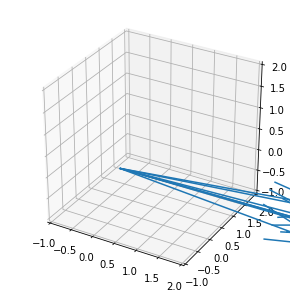

In [382]:
plot_directional_vectors(z_vectors)

The idea here is to use the very first (calibrating) vector which will help us create the plane of the shelf on which the products lie.

We will push this plane out from the origin in the direction of the calibrating vector by some quantity, and then find the points on the plane on which all of the other vectors intersect that (shelf) plane.

In [339]:
z_vectors[0]

array([ 0.9833239 , -0.17431676,  0.05184367])

In [338]:
# the coordinates in 3D where the shelf is
z_vectors[0] * 40 # 40 is some random approximation of the distance

array([39.33295616, -6.97267045,  2.07374699])

In [393]:
shelf_plane_norm = z_vectors[0]

In [406]:
DIST_ESTIMATE = 40

`z_vectors[0]` is the normal vector. The point above is the point where the shelf plane lies.

Equation of plane will always be:
$ax + by + cz + d_{estimate} = 0$, where $a$, $b$, and $c$ are the three parts of the normal vector.

Now find the point of intersection on the shelf plane with all of the other vectors extended out.

In [407]:
z_vectors[1]

array([ 0.9999347 ,  0.0104899 , -0.00453362])

In [419]:
def calculate_poi(p_vector, i_vector, dist_estimate):
    """
    Finds the point of intersection of a vector on the shelf plane.
    
    p_vector is plane vector
    i_vector is intersecting vector
    dist_estimate is estimate of shelf distance from person
    """
    coefficient = (p_vector[0] * i_vector[0]) + (p_vector[1] * i_vector[1]) + (p_vector[2] * i_vector[2])
    t = dist_estimate / coefficient
    poi = i_vector * t
    return poi

In [420]:
poi = calculate_poi(shelf_plane_norm, z_vectors[1], 40)
coordinates = [poi]
poi

array([40.76390892,  0.42763711, -0.18482001])

In [423]:
def plot_poi(p_norm, dist_est, coordinates):
    """
    Plots the points of intersection onto the shelf plane given
    the equation of the plane (ax + by + cz + d = 0) and the
    coordinates on the plane where the gaze intersected.
    
    p_norm     - plane norm
    dist_est   - distance estimate of shelf from person
    coordinate - list of POI
    """
    from mpl_toolkits.mplot3d import Axes3D
    
    fig = plt.figure(figsize=(5, 5))
    ax = fig.gca(projection='3d')
    ax.hold(True)
    
    # create x,y
    xx, yy = np.meshgrid(range(10), range(10))

    # calculate corresponding z
    z = (-p_norm[0] * xx - p_norm[1] * yy + dist_est) * 1. / p_norm[2]
    
    ax.plot_surface(xx, yy, z, alpha=0.5)
    
    for coord in coordinates:
        print(coord)
        ax.scatter(coord[0], coord[1], coord[2])

    plt.show()

[40.76390892  0.42763711 -0.18482001]


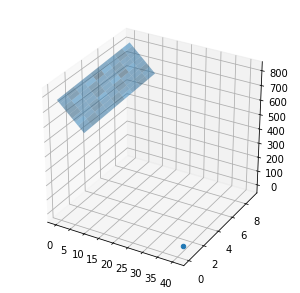

In [424]:
plot_poi(shelf_plane_norm, 40, coordinates)